# Home task: Clustering

## Part 1: KMeans

### Data

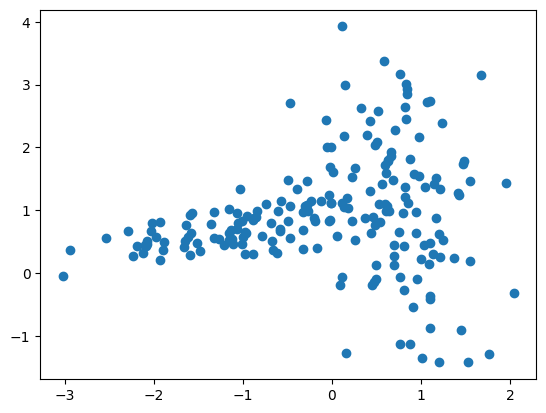

In [1]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
Xc_2,_= make_classification(n_samples=200,
                                    n_features=2,
                                    n_informative=2,
                                    n_redundant=0,
                                    random_state=0,
                                    n_clusters_per_class=1,
                                    class_sep = 0.8)
plt.figure()
plt.scatter  (Xc_2[:,0], Xc_2[:,1])

<font color = green >

###  Steps of implementatiion

</font>

1) Initialize $K$ centroids 

2) Assign every point to closest centroid 

3) Compute new centroids as means of samples assigned to corresponding centroid

4) Implement cost $J = \frac{1}{m}\underset{i}{\sum}(d^{(i)})^{2}$ where $d^{(i)}$ is distance from sample $x^{(i)}$ to assigned centroid $c^{(i)}$

5) Iterate setps 2,3 till cost is stabile 

6) Select the best clustering (with the least cost) from 100 results computed with random centroid  initializations 

7) Visualize results (clusters, centroids) for $K=4$

Note: 
* You may  need develop couple of additional/intermediate functions
* You may track cost changes to make sure the algorithm is working properly 

In [2]:
import numpy as np

class K_Means:
    def __init__(self, k, max_iters=100, verbose=False):
        self.k = k
        self.max_iters = max_iters
        self.centroids = []
        self.labels = []
        self.verbose = verbose
        self.costs = []
    
    def J(self, centroids, labels, X):
        all_dist = [] 
        for c_index in set(labels):
            assigned_samples = X[np.where(labels==c_index)]
            all_dist_centroid = np.linalg.norm(assigned_samples - centroids[c_index], axis=1)
            all_dist.append(np.sum(np.power(all_dist_centroid, 2)))
        m = len(labels)
        return 1/m* np.sum(all_dist)

    def fit(self, X):
        self.centroids = X[np.random.choice(range(X.shape[0]), size=self.k, replace=False)]
        
        for _ in range(self.max_iters):

            self.labels = np.argmin(np.linalg.norm(X[:, np.newaxis] - self.centroids, axis=-1), axis=-1)

            new_centroids = np.array([X[self.labels==i].mean(axis=0) for i in range(self.k)])

            cost = self.J(self.centroids, self.labels, X)
            
            if self.verbose:
                print(f"J: {cost}")
            
            if cost in self.costs:
                break

            self.costs.append(cost)

            self.centroids = new_centroids
    def predict(self, X):
        return np.argmin(np.linalg.norm(X[:, np.newaxis] - self.centroids, axis=-1), axis=-1)

J: 0.855566940906269
J: 0.5134444059971542
J: 0.49148123168629027
J: 0.4815460247175434
J: 0.47708788395573676
J: 0.47531537194031204
J: 0.47401582544735854
J: 0.47401582544735854


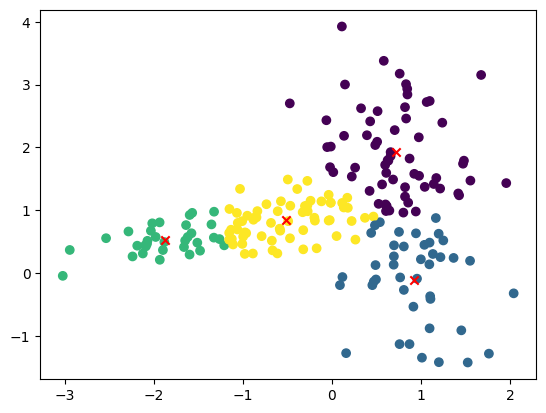

In [3]:
kmeans = K_Means(k=4, verbose=True)
kmeans.fit(Xc_2)
plt.scatter(Xc_2[:,0], Xc_2[:,1], c=kmeans.labels)
plt.scatter(kmeans.centroids[:,0], kmeans.centroids[:,1], c='r', marker='x')

### Comparing with Sklearn solution

c:\Users\sviat\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


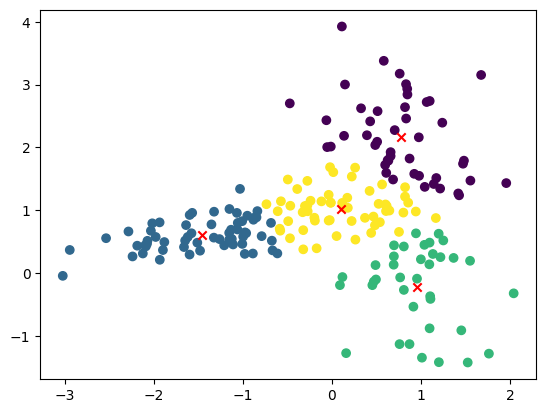

In [4]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=4)
kmeans.fit(Xc_2)

plt.scatter(Xc_2[:,0], Xc_2[:,1], c=kmeans.labels_)
plt.scatter(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1], c='r', marker='x')

## Part 2: Hierarchical clusterins and DBSCAN

Apply various clustering algorithms 

- Agglomerative clustering using `complete` linkage 
- Agglomerative clustering using `single` linkage 
- DBSCAN
- Use albow method to determine the best k for Kmeans

### Data

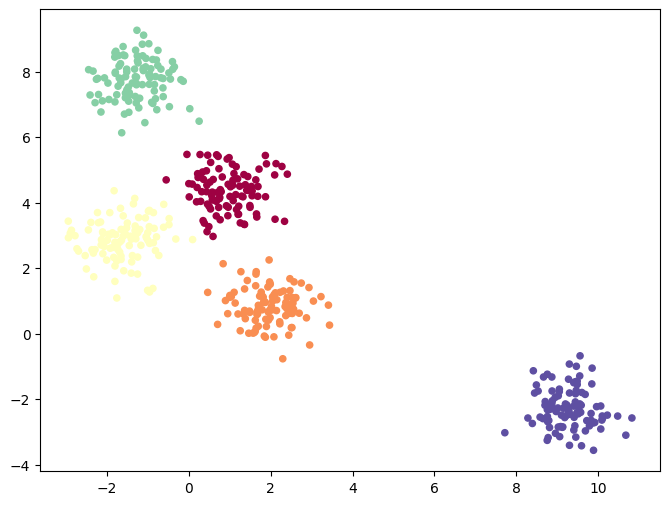

In [5]:
from sklearn.datasets import make_blobs
# %matplotlib notebook

X, y = make_blobs(n_samples = 500, n_features = 2, centers = 5, 
                           cluster_std = 0.6, random_state = 0)
colors = np.array([plt.cm.Spectral(val)
          for val in np.linspace(0, 1, len(set(y)))])
plt.figure(figsize=(8,6))

plt.scatter(X[:,0], X[:,1], c= colors[y], s= 20)    

### 1. Implementing Agglomerative clustering

In [11]:
import numpy as np
import time 

class AgglomerativeClustering:
    def __init__(self, n_clusters=2):
        self.n_clusters = n_clusters
    
    def calc_all_distances(self, points):
        all_distances = {}
        for i in range(len(points)):
            for j in range(i + 1):
                key_distance = f'{i}_{j}'
                reverse_key_distance = f'{j}_{i}'
                all_distances[key_distance] = all_distances[reverse_key_distance] = np.linalg.norm(points[i]-points[j])
        return all_distances

    def fit_predict(self, X):
        # Initialize each point to be a separate cluster
        clusters = [[i] for i in range(X.shape[0])]
        print(X.shape)
        self.all_distances = self.calc_all_distances(X)

        # While there are more than n_clusters clusters
        while len(clusters) > self.n_clusters:
            # Compute the distance matrix
            dist_matrix = self._compute_distance_matrix(X, clusters)

            # Find the pair of clusters with the smallest distance
            i, j = self._find_closest_clusters(dist_matrix)
            print(f"Remaining clusters: {len(clusters)}; distance: {dist_matrix[i, j]}")

            # Merge the closest clusters
            clusters[i] = clusters[i] + clusters[j]
            del clusters[j]

        # Assign a cluster label to each sample
        labels = np.empty(X.shape[0], dtype=np.int64)
        for i, cluster in enumerate(clusters):
            for j in cluster:
                labels[j] = i

        return labels

    def _compute_distance_matrix(self, X, clusters):
        n_clusters = len(clusters)
        dist_matrix = np.empty((n_clusters, n_clusters))

        for i in range(n_clusters):
            for j in range(i+1, n_clusters):
                start = time.time()
                dist_matrix[i, j] = self._compute_distance(X, clusters[i], clusters[j])
                print(f"Time taken: {time.time() - start}")
                dist_matrix[j, i] = dist_matrix[i, j]

        # A cluster should not be merged with itself
        np.fill_diagonal(dist_matrix, np.inf)

        return dist_matrix

    def _compute_distance(self, X, cluster_i, cluster_j):
        # Compute the Euclidean distance between the two clusters
        cluster_i_points = X[cluster_i]
        cluster_j_points = X[cluster_j]

        return np.mean([np.linalg.norm(a - b) for a in cluster_i_points for b in cluster_j_points])

    def _find_closest_clusters(self, dist_matrix):
        # Find the pair of clusters with the smallest distance
        return np.unravel_index(np.argmin(dist_matrix), dist_matrix.shape)


In [12]:
clustering = AgglomerativeClustering(n_clusters=5)
labels = clustering.fit_predict(X)
plt.scatter(X[:,0], X[:,1], c= colors[labels], s= 20)

(500, 2)
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0011813640594482422
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0015175342559814453
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: 0.0
Time taken: